In [1]:
from vega import VegaLite
from IPython.display import display
import json
import csv

In [2]:
def generate_rectangles(data):
     return {
    "title":"distance entre les variables",
      "width":1500,
      "height":1500,
      "data": data,
      "encoding": 
            {
            "y": {"field": "feature1", "type": "nominal"},
            "x": {"field": "feature2", "type": "nominal"}
            },
      "layer": [
            {
            "mark": "rect",
            "encoding": 
                {
                  "color": 
                      {
                      "field": "distance",
                      "type": "quantitative",
                      "scale":
                          {
                           "range": ["white", "blue", "black"]
                          }
                      },
                    "tooltip":
                    [
                        {"field":"distance", "type":"quantitative"},
                        {"field":"feature1", "type":"nominative"},
                        {"field":"feature2", "type":"nominative"}
                    ]
                }
            },
            {
            "mark": "text",
            "encoding":
                {
                "text": {"field": "distance", "type": "quantitative"},
                "color":
                    {
                    "condition": {"test": "datum['distance'] < 0.2", "value": "black"},
                    "value": "white"
                    }
                  }
            }
      ]
    }

In [3]:
def generate_ticks(data, width=1500, height=100):
    FEATURES_NAMES=["ARI", "nb_sent", "nb_word", "nb_char", "mean_cw", "mean_ws", "shortwords_prop" , "longwords_prop" , "dictwords_prop", "proper_noun_prop", "negation_prop1", "subjectivity_prop1", "verb_prop","past_verb_prop", "pres_verb_prop", "fut_verb_prop","imp_verb_prop", "plur_verb_prop","sing_verb_prop", "conditional_prop","question_prop","exclamative_prop","quote_prop","bracket_prop","noun_prop","cconj_prop", "sconj_prop", "pronp_prop", "adj_prop","adv_prop", "sttr", "comma_prop", "numbers_prop", "level0_prop", "level1_prop", "level2_prop", "autre_prop", "ner_prop", "person_prop", "norp_prop", "fac_prop", "org_prop", "gpe_prop", "loc_prop", "product_prop", "event_prop", "interpellation_prop1", "nous_prop1"]

    
    ticks={
      "title":"projections orthogonales des variables sur les 3 dimensions",
      "data": data,
      "width":width,
      "height":height,
      "encoding":
          {
        "y":{"field":"axis", "type":"ordinal"},
        "x":{"field":"value","type":"quantitative"}
          },
    "layer":[
        
        {
          "mark": "rule",
          "encoding":
              {
            "y": {"field": "axis", "type": "ordinal"},
            "color": {"value": "red"}
              }
        },
        {
        "mark": "tick",
        "encoding":
             {
            "color":{"field": "feature", "type":"nominal"},
            "size":{"value": 3}  
              }
        },
        {
        "selection":
            {
            "org1":
                {
                "empty":"all",
                "type":"single",
                "fields":["feature"]
                }
            },
        "mark": 
            {
            "type":"text",
            "angle":90
            },
        "encoding":
            {
            "text":{"field":"feature", "type":"nominal"},
            "color":
                    {
                    "condition":
                        {
                        "selection":"org1",
                        "type":"nominal",
                        "field":"feature"
                        },
                    "value":"black"
                    },
            "size":{"value":15},
            "tooltip":
                [
                    {"field":"feature", "type":"nominal"},
                    {"field":"value", "type":"quantitative"},
                ]
                
            }
        }
    ]

          }

    return ticks
 
                              

In [4]:
def generate_stacked_bars(data):
    data={"values":data}
    
    stacked_bars={
          "title":"nombre d'article en fonction de leur distance au baricentre dans chaque quartier",
          "width":600,
          "height":600,
          "data": data,
          "resolve": {"scale": {"color": "independent"}},
          "layer": [
        {
            "transform":[
                    { 
                    "calculate": "if(datum.distance_type === 'really close (<5e-1)', 5, if(datum.distance_type === 'close (5e-1< <1)', 4, if (datum.distance_type === 'close enought (1< <1.5)', 3, if(datum.distance_type === 'normal (1.5< <2.5)', 2, if(datum.distance_type === 'far (2.5<)', 1, 0)))))",
                    "as": "Type"
                    }
                ],
            "mark": "bar",
            "encoding": {
                "y": {"aggregate": "count", "field": "distance_type", "type": "quantitative", "stack": "zero"},
                "x": {"field": "quarter", "type": "nominal"},
                "color": {"field": "distance_type", "type": "nominal"},
                "order":
                        {
                        "field": "Type",  
                        "type": "quantitative"
                        }
                      }
        },
        {
            "transform":[
                    { 
                    "calculate": "if(datum.distance_type === 'really close (<5e-1)', 5, if(datum.distance_type === 'close (5e-1< <1)', 4, if (datum.distance_type === 'close enought (1< <1.5)', 3, if(datum.distance_type === 'normal (1.5< <2.5)', 2, if(datum.distance_type === 'far (2.5<)', 1, 0)))))",
                    "as": "Type"
                    }
                ],
            "mark": {"type": "text", "baseline":"top", "dy":2},
            "encoding": {
            "y": {"aggregate": "count", "field": "distance_type", "type": "quantitative", "stack": "zero"},
            "x": {"field": "quarter", "type": "nominal"},
            "color": {"field": "distance_type", "type": "nominal", "scale": {"range": ["white"]}, "legend": None},
            "text": {"aggregate": "count", "field": "distance_type", "type": "quantitative", "format": ".1f"},
            "order":
                    {
                    "field": "Type",  
                    "type": "quantitative"
                    }
                  }
    }
  ]
}
    
    return stacked_bars
    

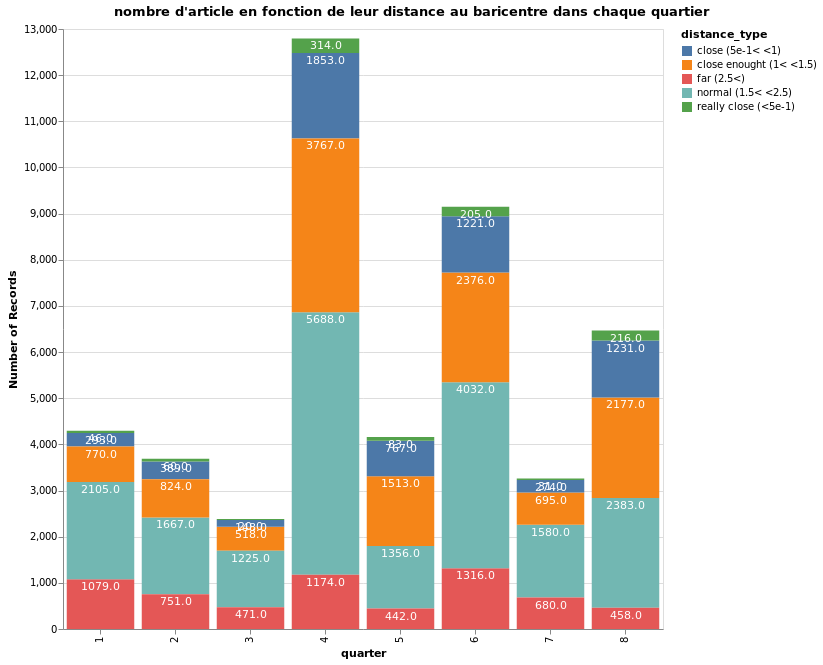

In [5]:
with open('data/stories_baricenter_distribution_3D.json', 'r') as f:
    values=json.load(f)

VegaLite(generate_stacked_bars(values))

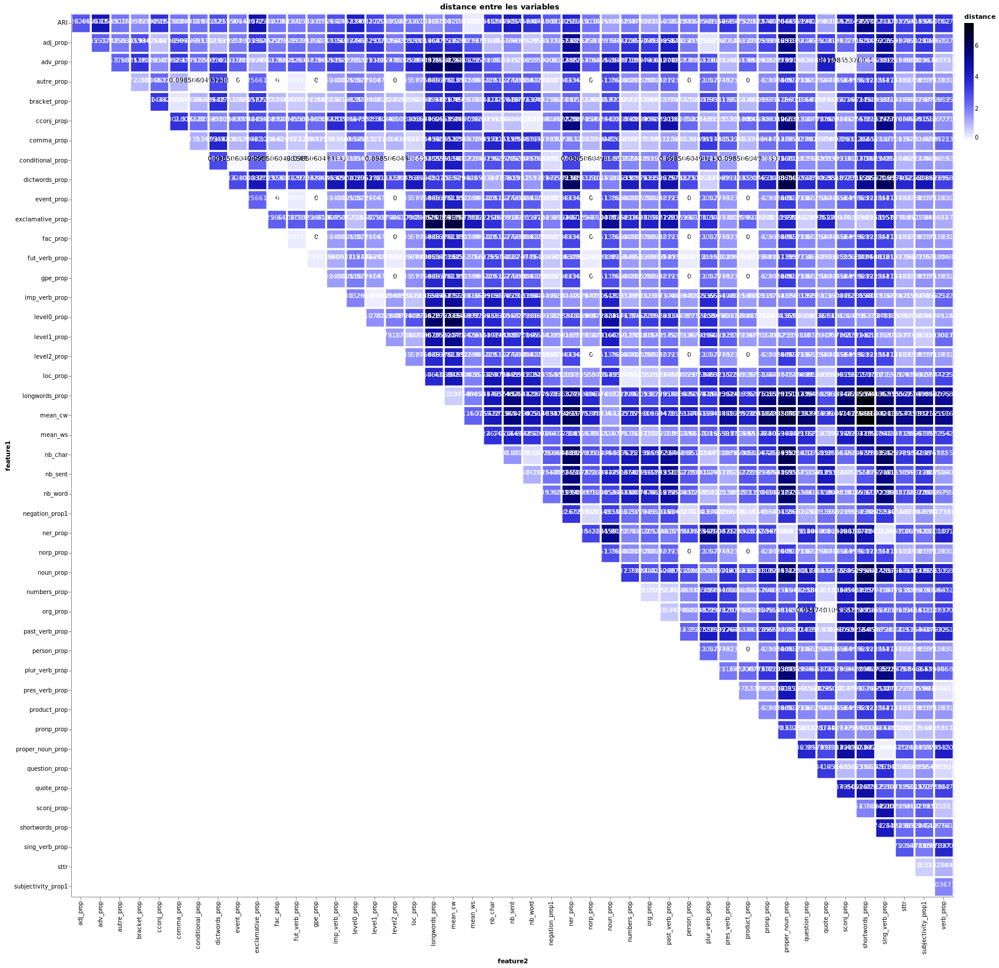

In [13]:
with open('data/features_distances.json', 'r') as f:
    values=json.load(f)
data={"values":values}

VegaLite(generate_rectangles(data))

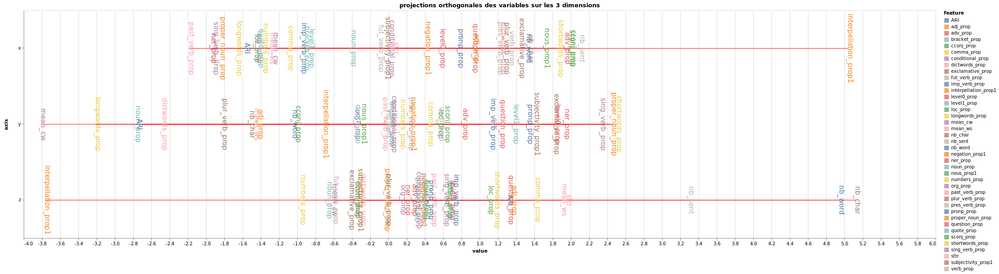

In [6]:
with open('data/vector_mean_data_3D.json', 'r') as f:
    values=json.load(f)

data={"values":[]}
    
for value in values:
    if value["x"]!=0 and value["y"]!=0:
        new1={"feature":value["feature"],"axis":"x", "value":value["x"]}
        new2={"feature":value["feature"],"axis":"y", "value":value["y"]}
        new3={"feature":value["feature"],"axis":"z", "value":value["z"]}

        data["values"].append(new1)
        data["values"].append(new2)
        data["values"].append(new3)
    
ticks=generate_ticks(data, 2000, 500)
VegaLite(ticks)

In [7]:
with open('data/vector_mean_data_2D.json', 'r') as f:
    values=json.load(f)

data={"values":[]}
    
for value in values:
    if value["x"]!=0 and value["y"]!=0:
        new1={"feature":value["feature"],"axis":"x", "value":value["x"]}
        new2={"feature":value["feature"],"axis":"y", "value":value["y"]}
        new3={"feature":value["feature"],"axis":"z", "value":value["z"]}

        data["values"].append(new1)
        data["values"].append(new2)
        data["values"].append(new3)
    
ticks=generate_ticks(data, 2000, 500)
VegaLite(ticks)

KeyError: 'z'

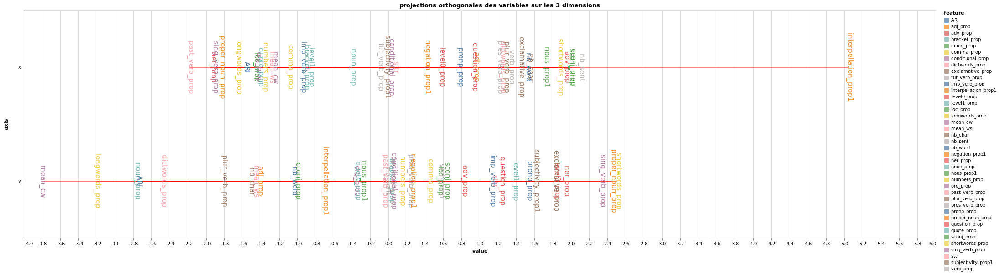

In [8]:
with open('data/vector_mean_data_2D.json', 'r') as f:
    values=json.load(f)

data={"values":[]}
    
for value in values:
    if value["x"]!=0 and value["y"]!=0:
        new1={"feature":value["feature"],"axis":"x", "value":value["x"]}
        new2={"feature":value["feature"],"axis":"y", "value":value["y"]}

        data["values"].append(new1)
        data["values"].append(new2)
    
ticks=generate_ticks(data, 2000, 500)
VegaLite(ticks)